# Data Generation (Image Processing)


In [ ]:
!pip install ipyplot
!pip install kaggle
!mkdir /root/.kaggle
!cp -p kaggle.json /root/.kaggle/.
!rm -f -r annotations images
!kaggle datasets download -d jessicali9530/stanford-dogs-dataset
!unzip \*.zip  && rm *.zip

Streaming output truncated to the last 5000 lines.
  inflating: images/Images/n02108089-boxer/n02108089_11687.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_117.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_11807.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_11875.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_122.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_12232.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_125.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_12738.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_12739.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_12827.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_13340.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_13526.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_1353.jpg  
  inflating: images/Images/n02108089-boxer/n02108089_1355.jpg  
  inflating: images/Images/n02108089-boxer/n021

In [ ]:
import random, os
import cv2
from google.colab.patches import cv2_imshow
import ipyplot
import numpy as np
import keras
from keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt

import warnings 
warnings.filterwarnings('ignore')


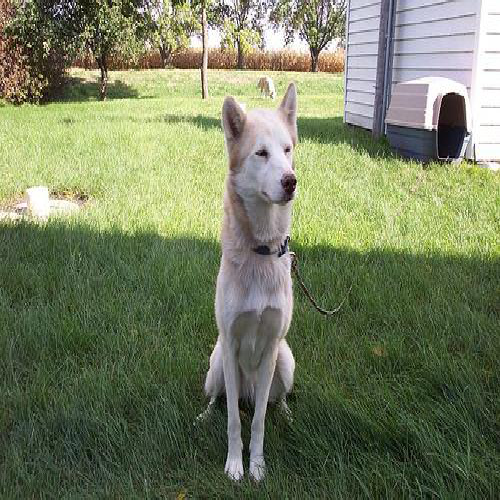
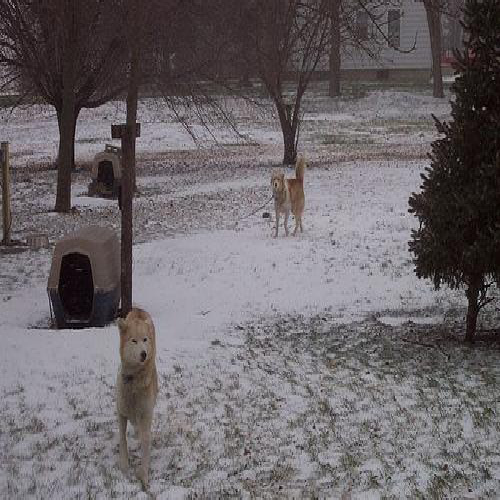
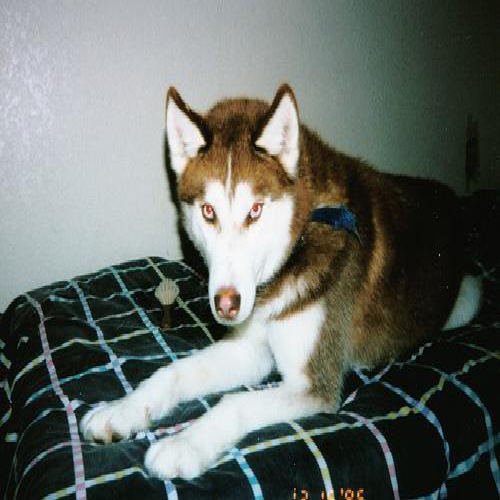
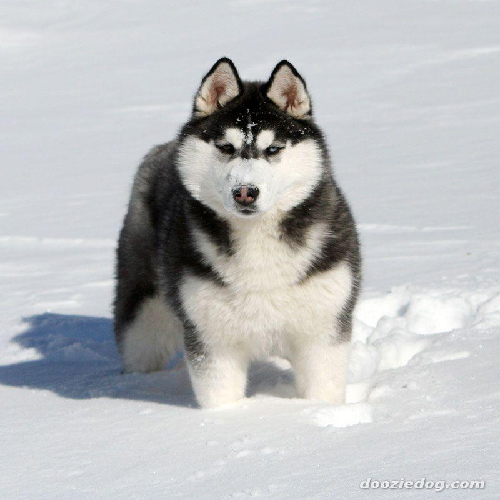
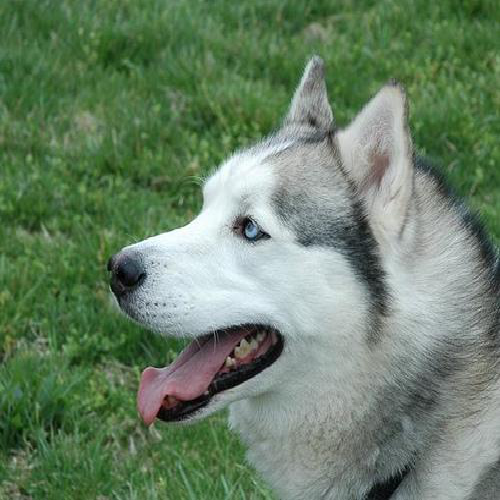


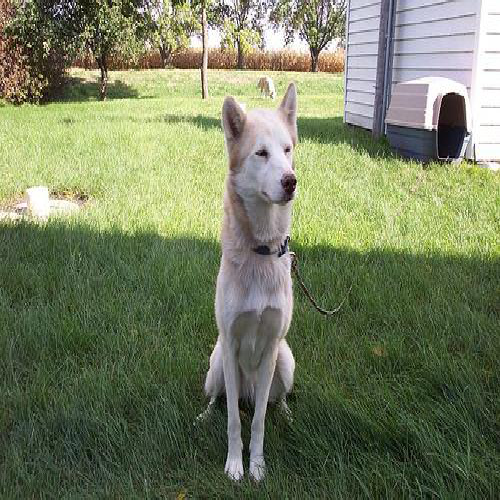
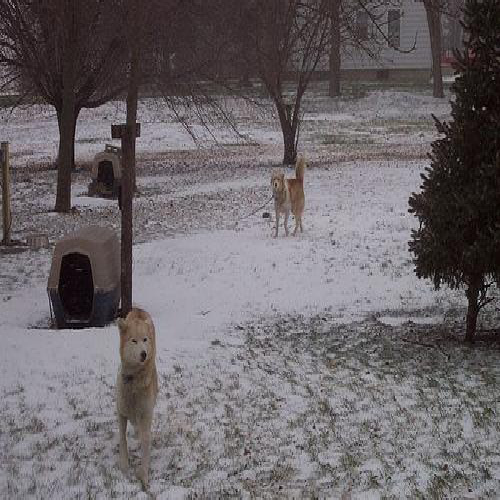
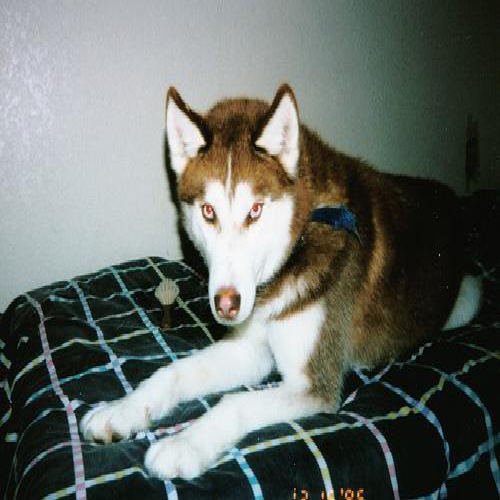
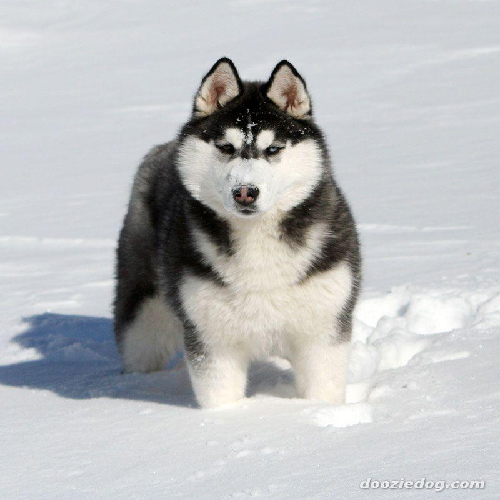
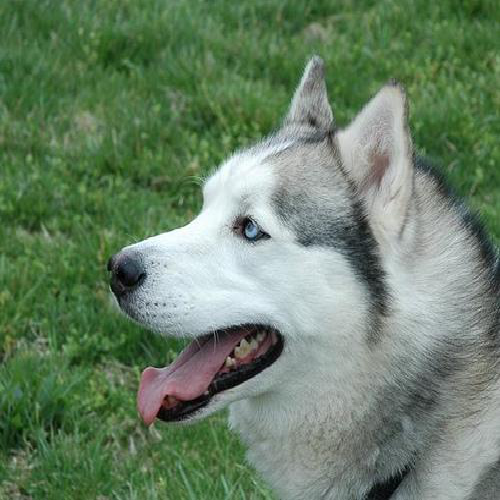

In [ ]:
DATASET_PATH = '/content/images/Images/n02110185-Siberian_husky'

SAMPLE = random.sample(os.listdir(DATASET_PATH),5)

imagelist = []
image_tensors = []

for image in SAMPLE:
  img = keras.preprocessing.image.load_img(os.path.join(DATASET_PATH,image), target_size= (500,500))
  img_tensor = keras.preprocessing.image.img_to_array(img)
  img_tensor = np.expand_dims(img_tensor, axis=0)
  image_tensors.append(img_tensor)
  imagelist.append(np.array(img))


ipyplot.plot_images(imagelist, max_images=len(SAMPLE), img_width=150)

(500, 500, 3)
(1, 500, 500, 3)


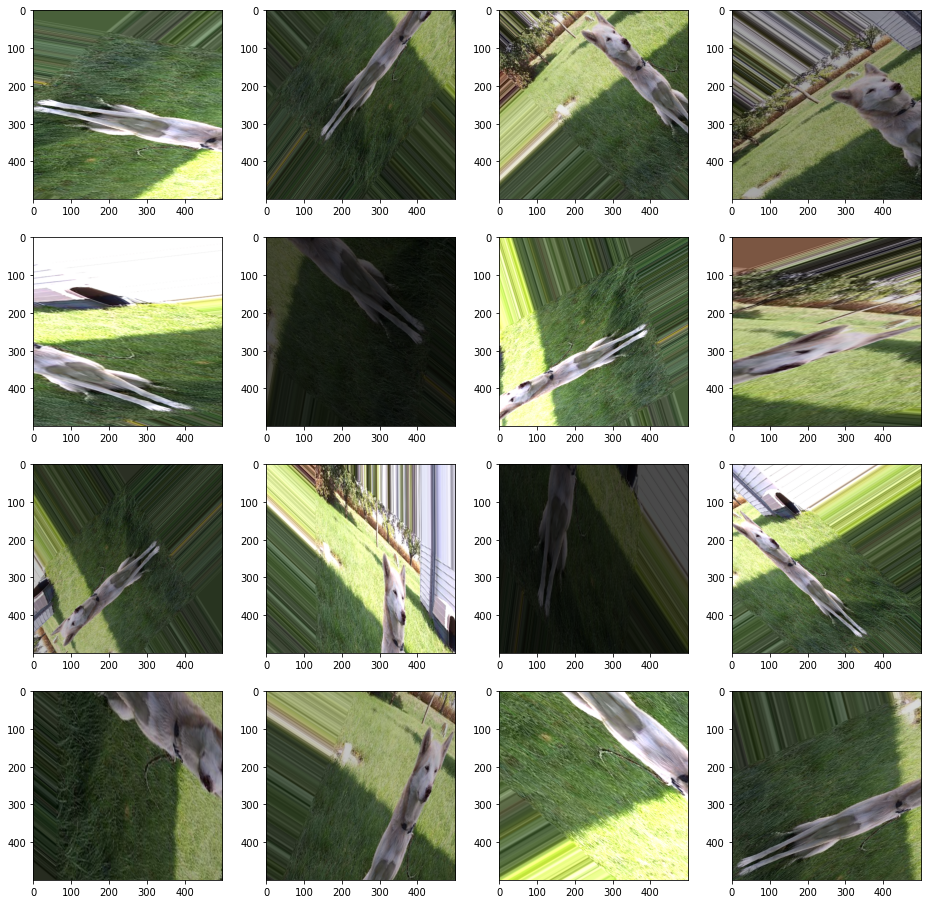

(500, 500, 3)
(1, 500, 500, 3)


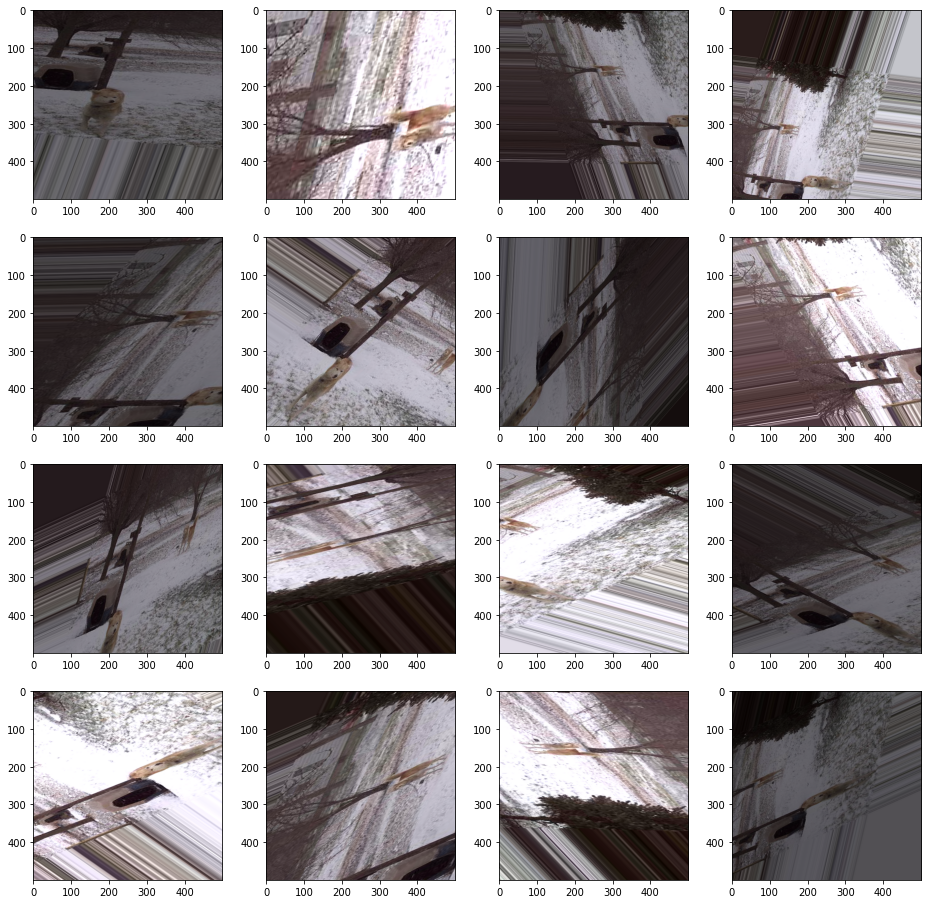

(500, 500, 3)
(1, 500, 500, 3)


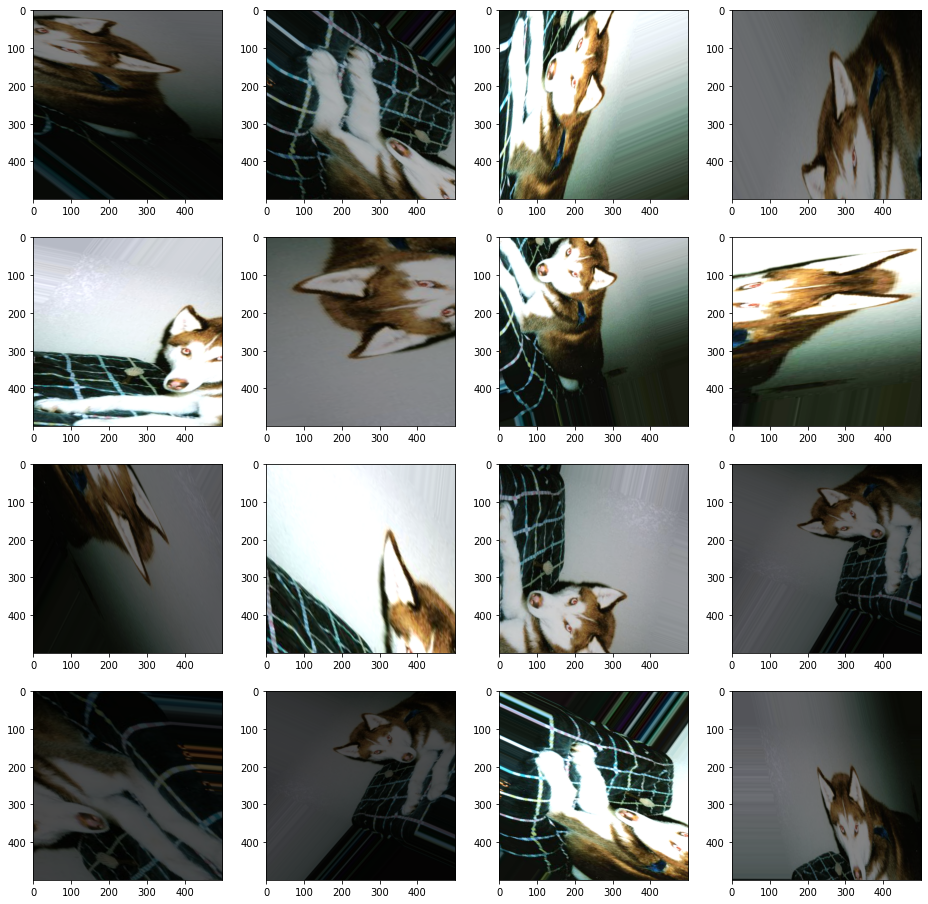

(500, 500, 3)
(1, 500, 500, 3)


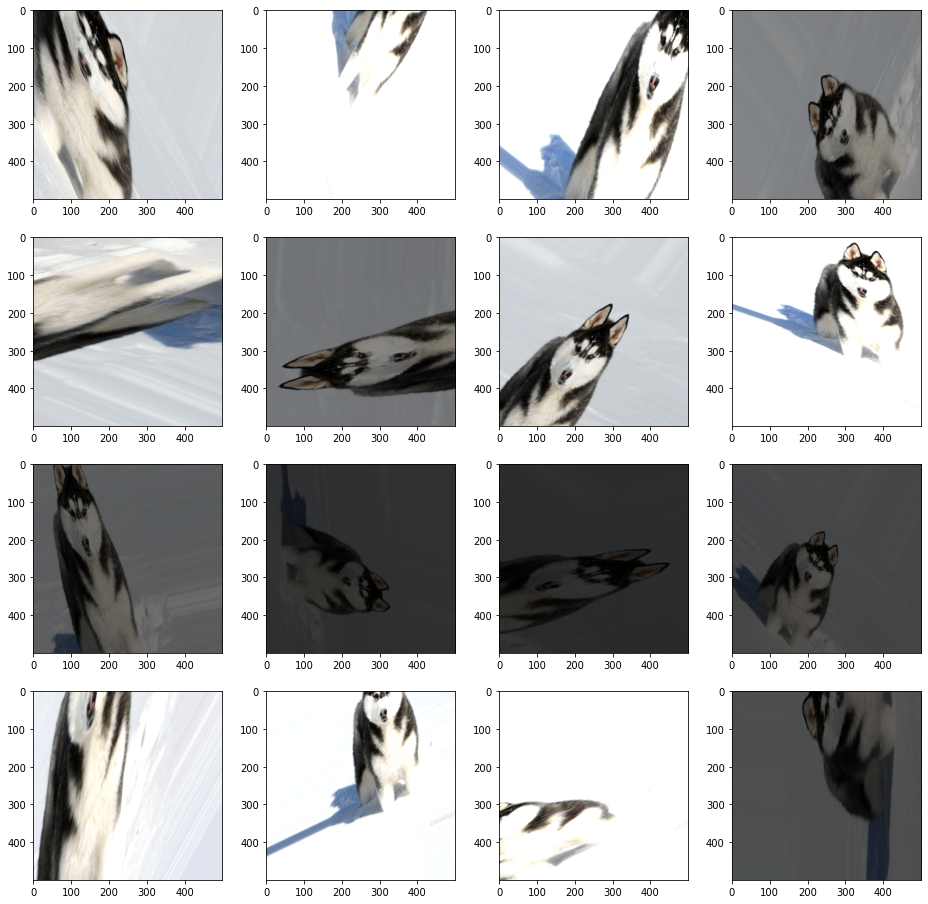

(500, 500, 3)
(1, 500, 500, 3)


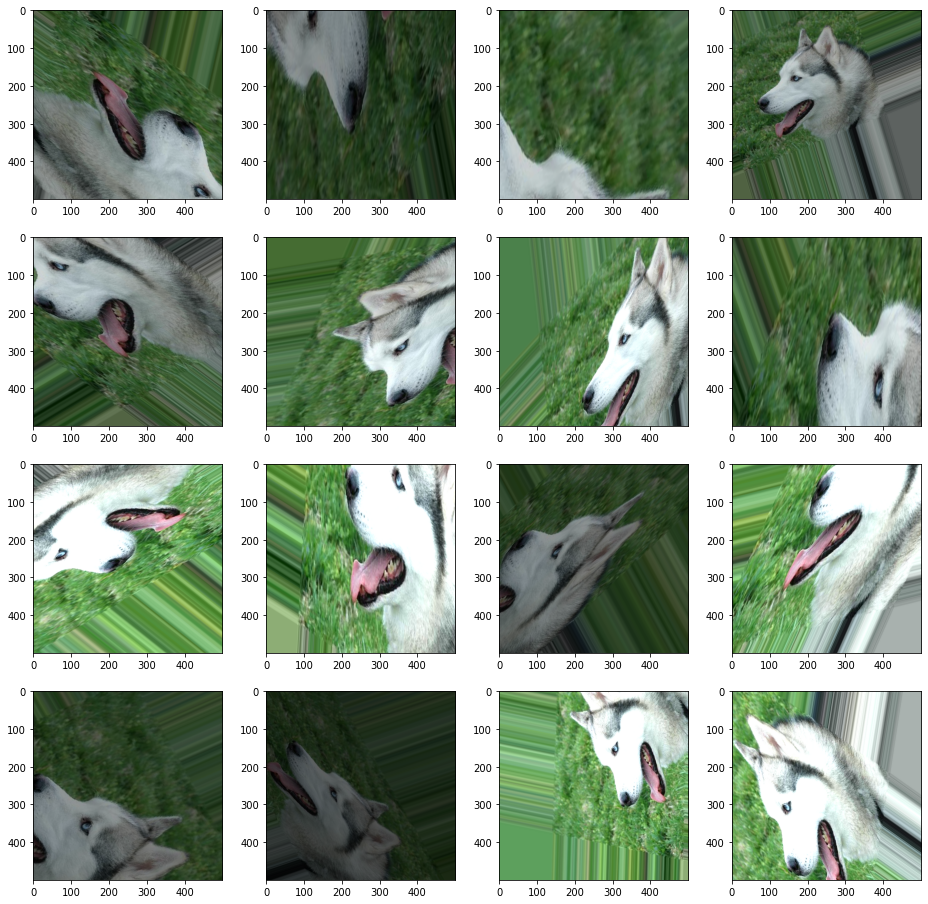

In [ ]:
def test_image_generator(image, case):
  img = keras.preprocessing.image.load_img(os.path.join(DATASET_PATH,image), target_size= (500,500))
  img_tensor = keras.preprocessing.image.img_to_array(img)
  print(img_tensor.shape)
  img_tensor = np.expand_dims(img_tensor, axis=0)   # Since we are working with one image, we reshape the image tensors to include the numer
  print(img_tensor.shape)
  
  # Alternative
  # img = keras.preprocessing.image.load_img(os.path.join(DATASET_PATH,SAMPLE[0]), target_size= (500,500))
  # img_tensor1 = keras.preprocessing.image.img_to_array(img)
  # img = keras.preprocessing.image.load_img(os.path.join(DATASET_PATH,SAMPLE[1]), target_size= (500,500))
  # img_tensor2 = keras.preprocessing.image.img_to_array(img)
  # img_tensor = np.array([img_tensor1,img_tensor2])

  if case!=0:
    if case==1: # Flipping the images
      datagen = ImageDataGenerator(horizontal_flip=True, vertical_flip=True)

    elif case==2: # Horizontal shift
      datagen = ImageDataGenerator(width_shift_range=[-150, 150])

    elif case==3: # Rotational shift
      datagen = ImageDataGenerator(rotation_range=120)

    elif case==4: # Brightness adjustment
      datagen = ImageDataGenerator(brightness_range=[0.1, 2.0])

    elif case==5: # Zoom adjustment
      datagen = ImageDataGenerator(zoom_range=0.6) # [0.4,1.6]

    elif case==6: # Shear adjustment
      datagen = ImageDataGenerator(shear_range=50)
    
    # Display logic
    pic = datagen.flow(img_tensor, batch_size = img_tensor.shape[0])
    plt.figure(figsize=(10,8))

    for i in range(1,4): # range should be between the limits set by the subplot (rows x columns)
      plt.subplot(1, 3, i) # (rows, columns, index)
      batch = pic.next()
      new_image = batch[0].astype('uint8')
      plt.imshow(new_image)
    plt.show()
  
  else:
    datagen = ImageDataGenerator(width_shift_range=[-100, 100],          
                        height_shift_range=[-100, 100], 
                        rotation_range=120, brightness_range=[0.2, 1.5],
                        zoom_range = [0.3, 1.5] ,shear_range=50)
    
    pic = datagen.flow(img_tensor, batch_size = img_tensor.shape[0])
    plt.figure(figsize=(16, 16))
    
    
    for i in range(1,17):
      plt.subplot(4, 4, i)
      batch = pic.next()
      new_image = batch[0].astype('uint8')
      plt.imshow(new_image)
    plt.show()

for image in SAMPLE:
  test_image_generator(image,0)

More on ImageDataGenerator - https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image/ImageDataGenerator

# Extracting relevant data in image processing

![mask.png](https://929687.smushcdn.com/2407837/wp-content/uploads/2020/09/maskrcnn_grabcut_initial_segmentation.png?lossy=1&strip=1&webp=1)

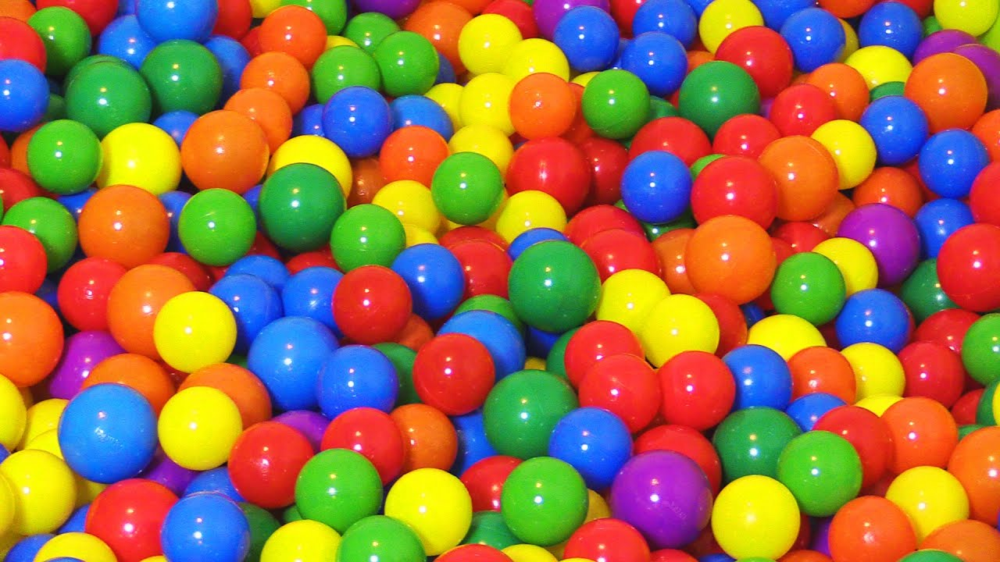

In [ ]:
image = cv2.imread('ball_pit.jpg')
cv2_imshow(image)

hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV) # Hue Saturation Value (Color scale - similar to RGB)


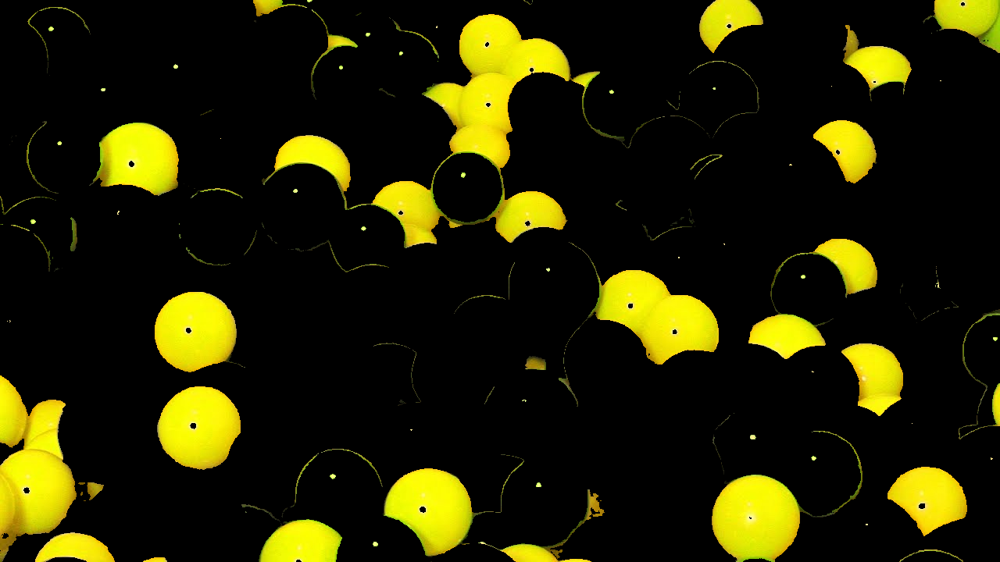

In [ ]:
lower_bound = { 'blue': np.array([100,150,0], dtype=np.uint8),
         'green': np.array([36,25,25], dtype=np.uint8),
         'red': np.array([0,30,40], dtype=np.uint8),
         'yellow': np.array([22,93,0], dtype=np.uint8),
         'purple': np.array([120,160,20], dtype=np.uint8)}
         
upper_bound = { 'blue': np.array([140,255,255], dtype=np.uint8),
         'green': np.array([70,255,255], dtype=np.uint8),
         'red': np.array([20,255,255], dtype=np.uint8),
         'yellow': np.array([40,255,255], dtype=np.uint8),
         'purple': np.array([160,255,255], dtype=np.uint8)}


#extract color from image
color = 'yellow' 
mask = cv2.inRange(hsv, lower_bound[color], upper_bound[color])
res = cv2.bitwise_and(image,image, mask= mask) # Only the parts satisfying the mask an the image will b displayed (1 && 1 = 1)

# cv2_imshow(mask)
cv2_imshow(res)

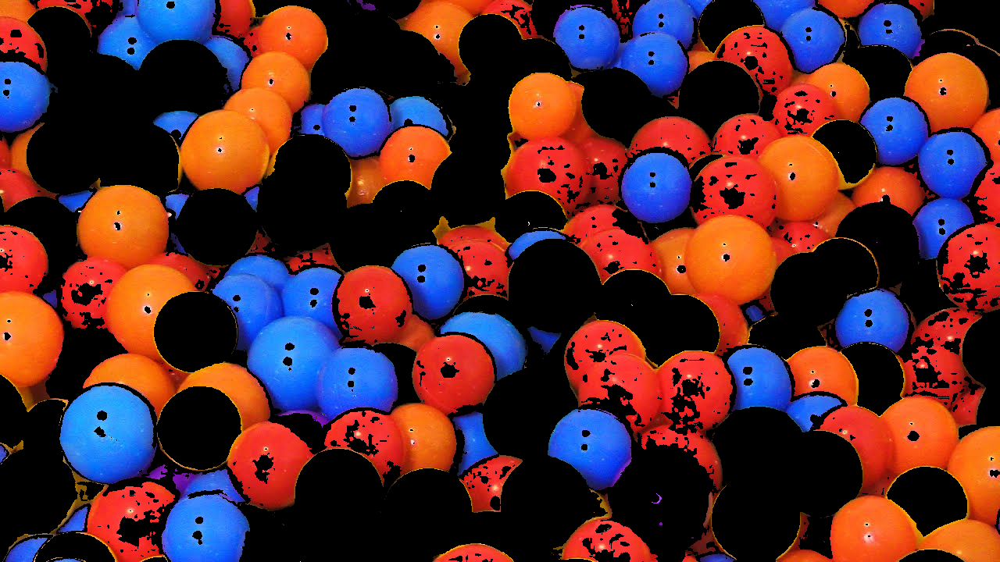

In [ ]:
# get multiple colours

red_mask = cv2.inRange(hsv, lower_bound['red'], upper_bound['red'])
blue_mask = cv2.inRange(hsv, lower_bound['blue'], upper_bound['blue'])

mask = cv2.bitwise_or(red_mask,blue_mask)
res = cv2.bitwise_and(image,image, mask= mask) # Only the parts satisfying the mask an the image will b displayed (1 && 1 = 1)

cv2_imshow(res)

# Simple Document Scanner

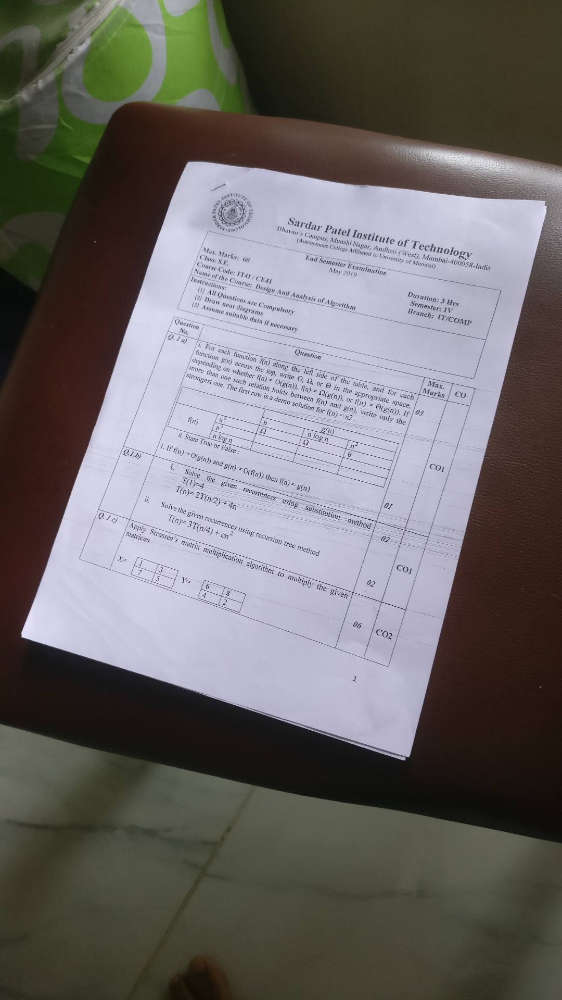

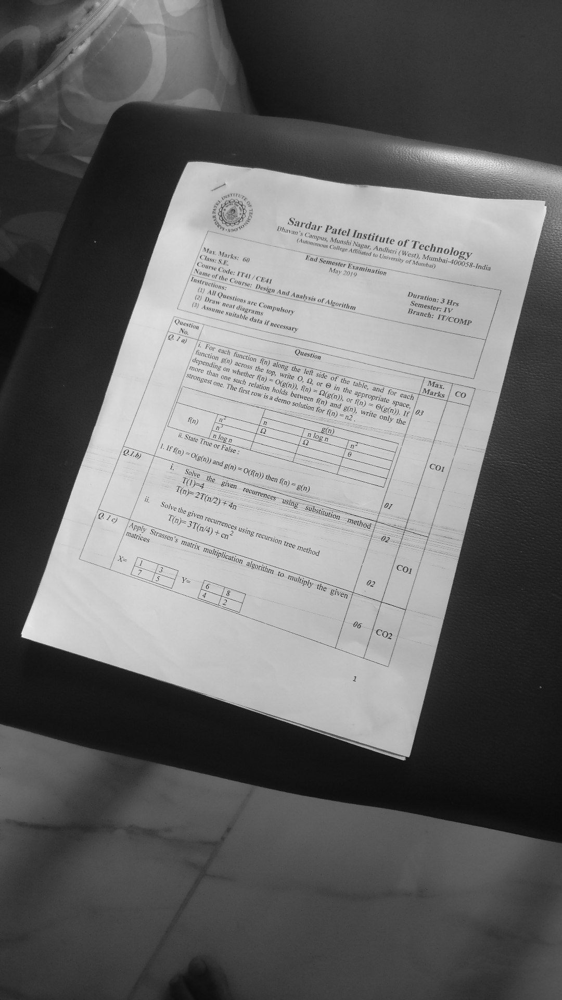

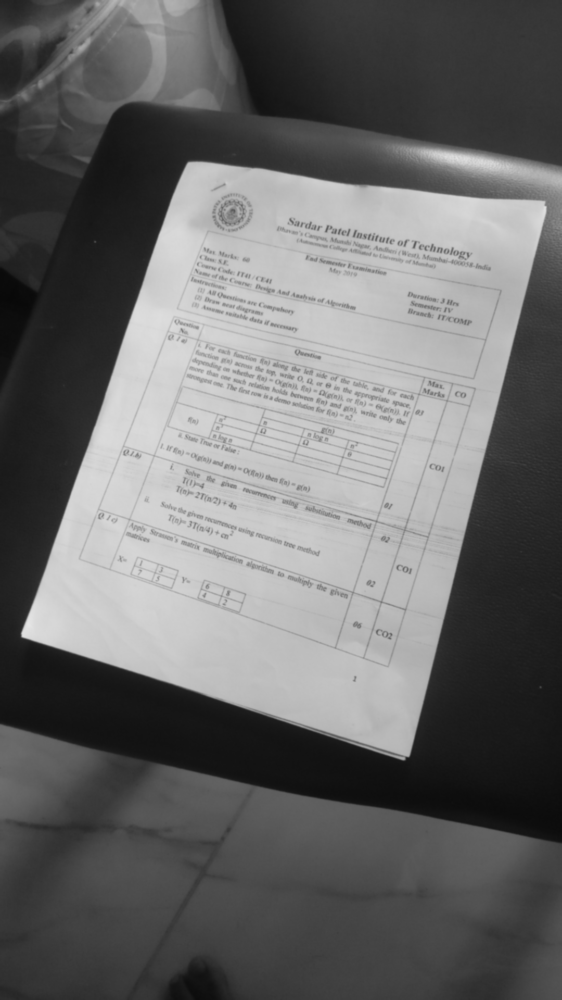

In [ ]:
import numpy as np 
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread("/content/text.png",1)

#resize image
img = cv2.resize(img,(1080,1920))
cv2_imshow(img)
#convert image to grayscale
grey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2.imwrite('gray.png',grey)
cv2_imshow(grey)

#blur image to smooth 
blurr = cv2.GaussianBlur(grey, (5,5),0)
cv2.imwrite('blur.png',blurr)
cv2_imshow(blurr)


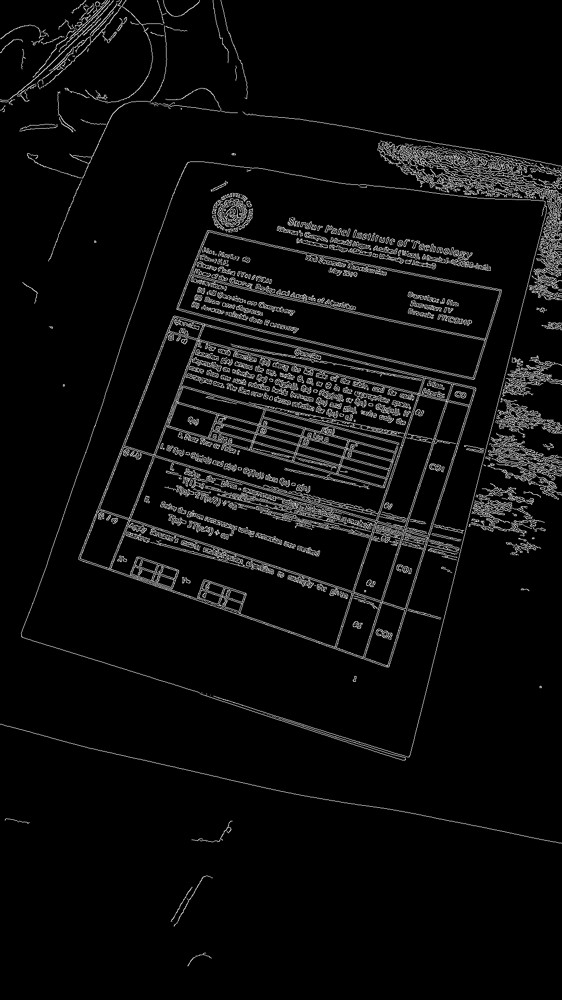

In [ ]:
#finding edges 
edge = cv2.Canny(blurr, 0, 50)   
cv2.imwrite('canny.png',edge)
cv2_imshow(edge)

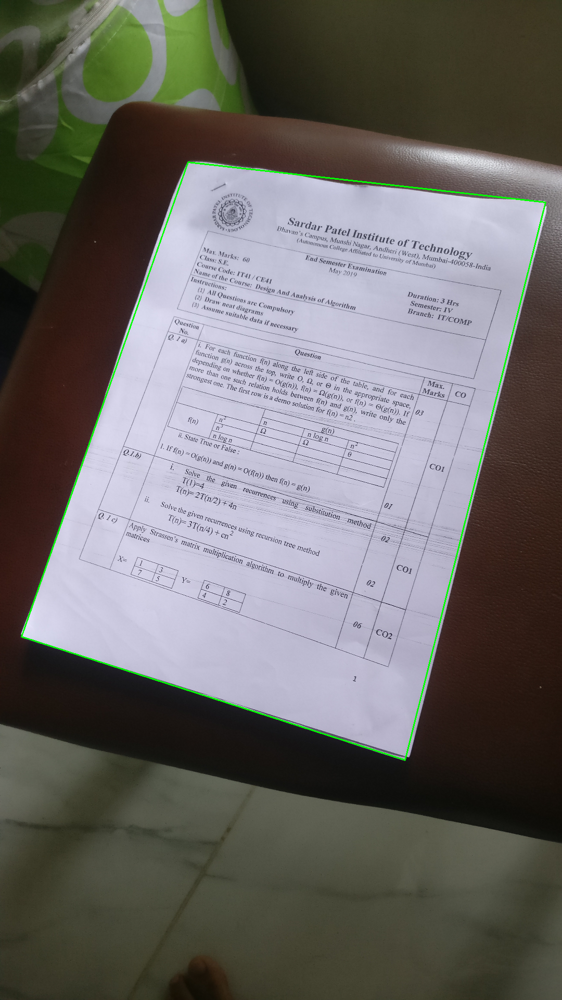

In [ ]:
#finding contours
(contours, _) = cv2.findContours(edge, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
contours = sorted(contours, key=cv2.contourArea, reverse= True)

#contour approximation 
for i in contours:
	elip =  cv2.arcLength(i, True)
	approx = cv2.approxPolyDP(i,0.08*elip, True)

	if len(approx) == 4 : 
		doc = approx 
		break

#draw contours 
cv2.drawContours(img, [doc], -1, (0, 255, 0), 2)

doc=doc.reshape((4,2))
cv2_imshow(img)

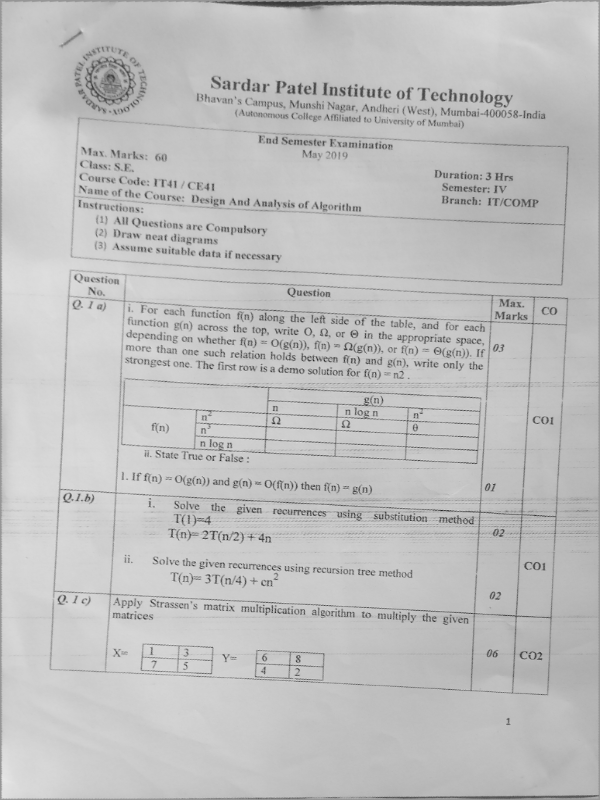

In [ ]:
#create a new array and initialize 
new_doc = np.zeros((4,2), dtype="float32")

Sum = doc.sum(axis = 1)
new_doc[0] = doc[np.argmin(Sum)]
new_doc[2] = doc[np.argmax(Sum)]

Diff = np.diff(doc, axis=1)
new_doc[1] = doc[np.argmin(Diff)]
new_doc[3] = doc[np.argmax(Diff)]

(tl,tr,br,bl) = new_doc

#find distance between points and get max 
dist1 = np.linalg.norm(br-bl)
dist2 = np.linalg.norm(tr-tl)

maxLen = max(int(dist1),int(dist2))

dist3 = np.linalg.norm(tr-br)
dist4 = np.linalg.norm(tl-bl)

maxHeight = max(int(dist3), int(dist4))
# print(maxHeight)

dst = np.array([[0,0],[maxLen-1, 0],[maxLen-1, maxHeight-1], [0, maxHeight-1]], dtype="float32")

N = cv2.getPerspectiveTransform(new_doc, dst)
warp = cv2.warpPerspective(img, N, (maxLen, maxHeight))

img2 = cv2.cvtColor(warp, cv2.COLOR_BGR2GRAY)
img2 = cv2.resize(img2,(600,800))
cv2_imshow(img2)

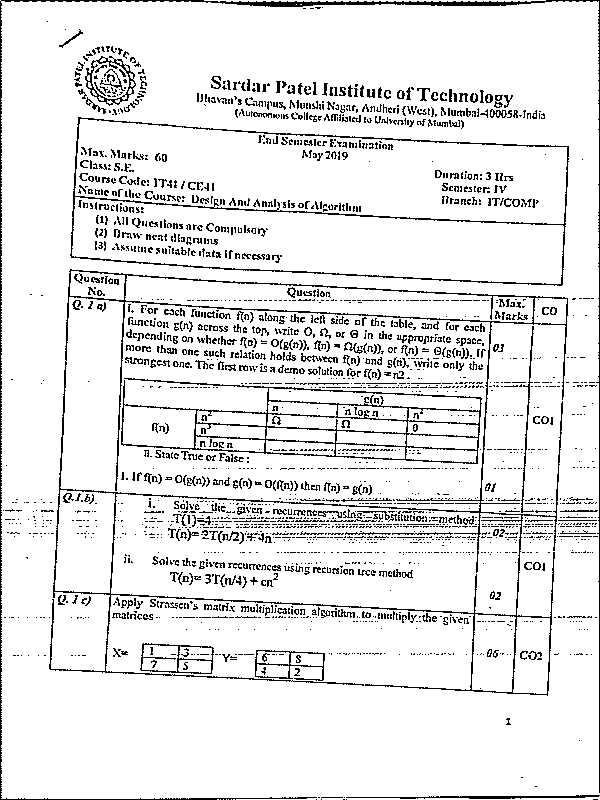

In [ ]:
th1 = cv2.adaptiveThreshold(img2 ,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,5,5)
cv2_imshow(th1)